In [3]:
!accelerate launch train_dreambooth.py \
  --pretrained_model_name_or_path=$MODEL_NAME \
  --pretrained_vae_name_or_path="/content/content/diffusers/models--stabilityai--sd-vae-ft-mse/snapshots/ad7ac2cf88578c68f660449f60fe9496f35a1cbf" \
  --output_dir=$OUTPUT_DIR \
  --revision="fp16" \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --seed=1337 \
  --resolution=512 \
  --train_batch_size=1 \
  --train_text_encoder \
  --mixed_precision="fp16" \
  --use_8bit_adam \
  --gradient_accumulation_steps=1 \
  --learning_rate=1e-6 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=280\
  --num_class_images=420 \
  --sample_batch_size=4 \
  --max_train_steps=3230 \
  --save_interval=10000 \
  --save_sample_prompt="secourses" \
  --concepts_list="concepts_list.json"
# num_class_images  images*12 26*12 =312 
# max_train_steps   images*80 26*80 = 2080
# lr_warmup_steps int(max_train_steps / 10) = 208 
# Reduce the `--save_interval` to lower than `--max_train_steps` to save weights from intermediate steps.
# `--save_sample_prompt` can be same as `--instance_prompt` to generate intermediate samples (saved along with weights in samples directory).

	`--num_processes` was set to a value of `1`
	`--num_machines` was set to a value of `1`
	`--mixed_precision` was set to a value of `'no'`
	`--dynamo_backend` was set to a value of `'no'`
To avoid this warning pass in values for each of the problematic parameters or run `accelerate config`.

===================================BUG REPORT===================================
Welcome to bitsandbytes. For bug reports, please submit your error trace to: https://github.com/TimDettmers/bitsandbytes/issues
For effortless bug reporting copy-paste your error into this form: https://docs.google.com/forms/d/e/1FAIpQLScPB8emS3Thkp66nvqwmjTEgxp8Y9ufuWTzFyr9kJ5AoI47dQ/viewform?usp=sf_link
/usr/local/lib/python3.8/dist-packages/bitsandbytes/cuda_setup/paths.py:105: UserWarning: /usr/lib64-nvidia did not contain libcudart.so as expected! Searching further paths...
  warn(
/usr/local/lib/python3.8/dist-packages/bitsandbytes/cuda_setup/paths.py:27: UserWarning: WARNING: The following directories listed in 

  0%|          | 0/50 [00:00<?, ?it/s]

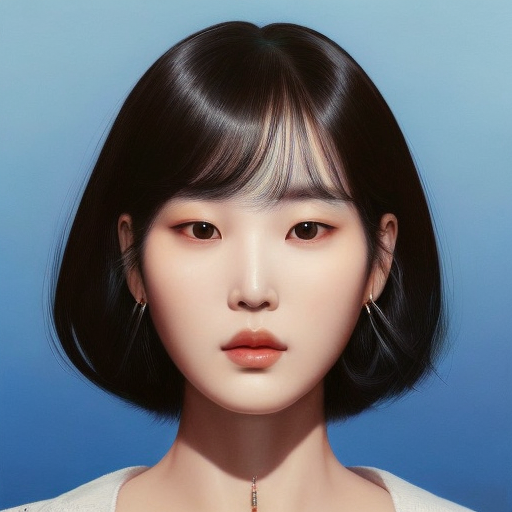

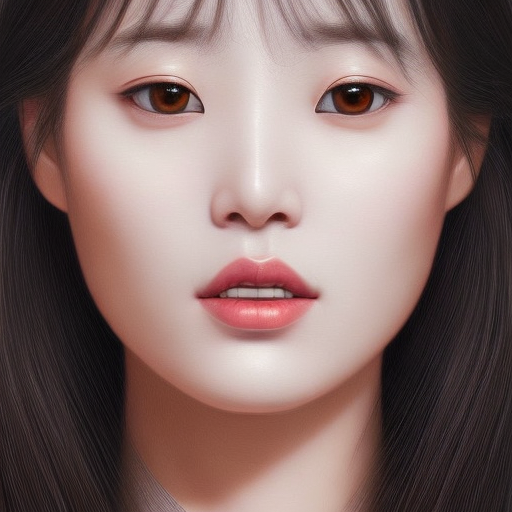

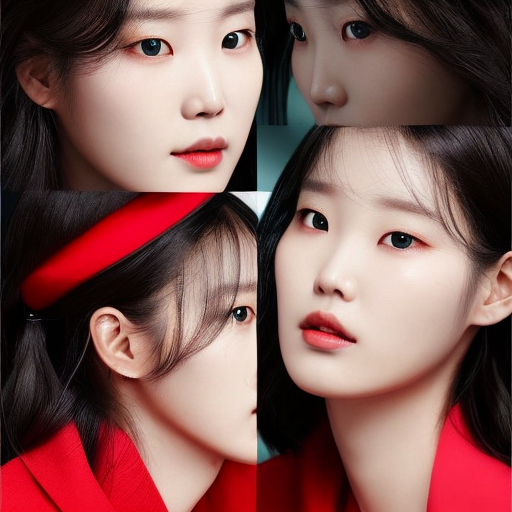

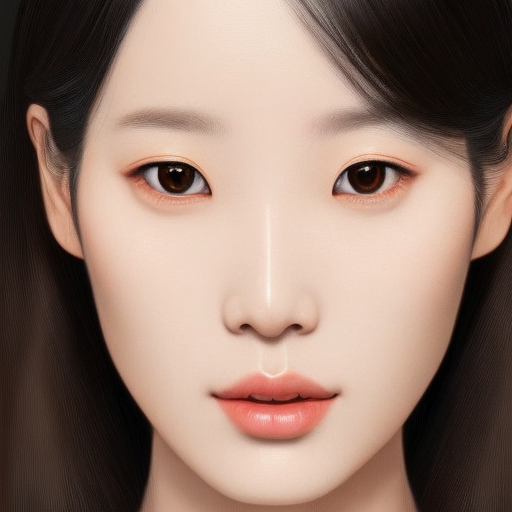

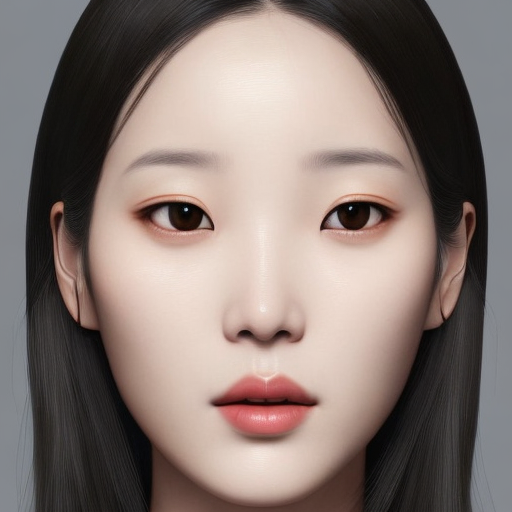

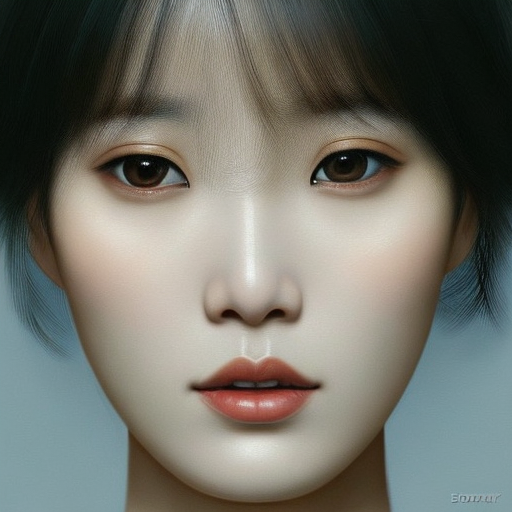

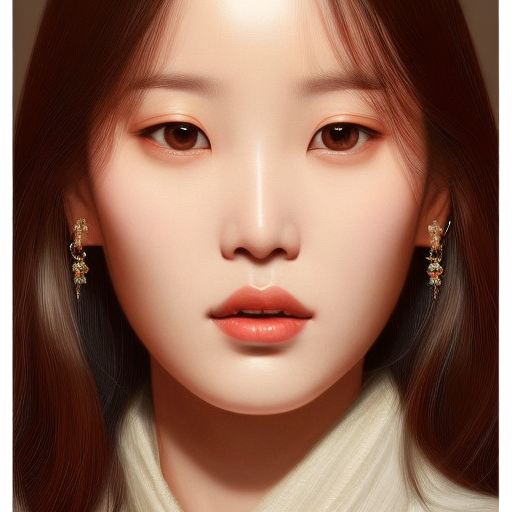

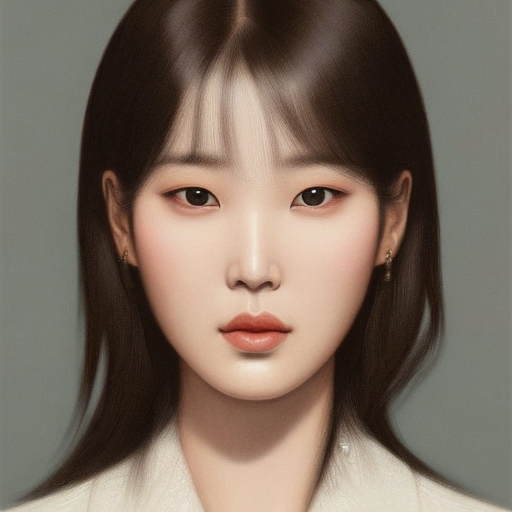

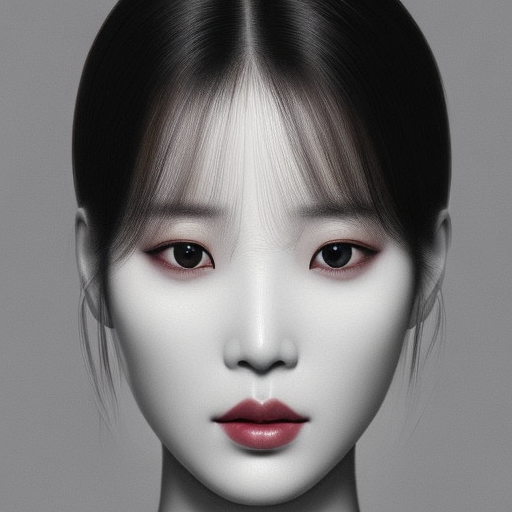

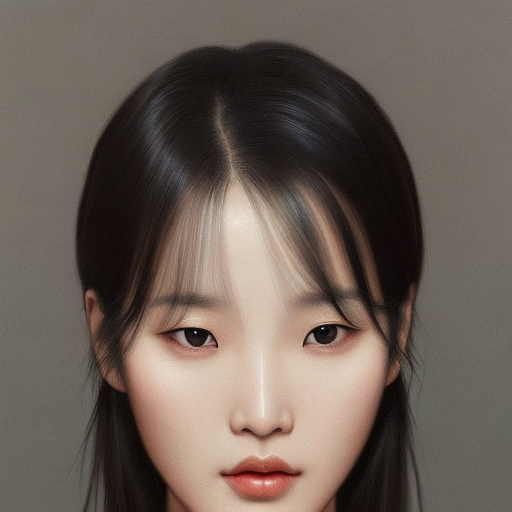

In [6]:
#@title Run for generating images.

prompt = "face portrait of secourses, symmetrical, detailed face, insanely detailed, concept art, trending on artstation, daily deviations Highly Realistic sharp, elegant. by Rockstar Games, digital painting, looking into the camera" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for index,img in enumerate(images):
    img.save(os.path.join("/content/output",str(index)+".jpg"))
    display(img)

  0%|          | 0/80 [00:00<?, ?it/s]

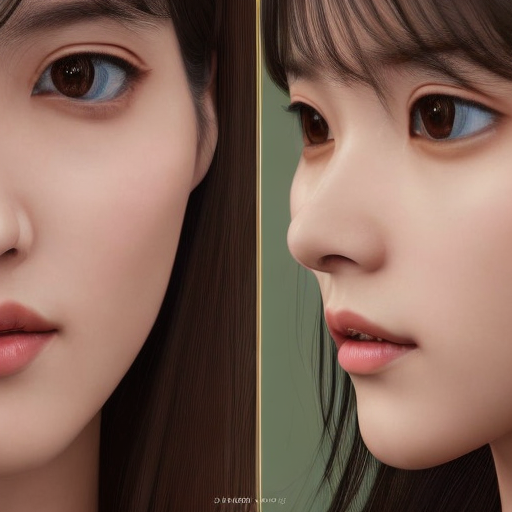

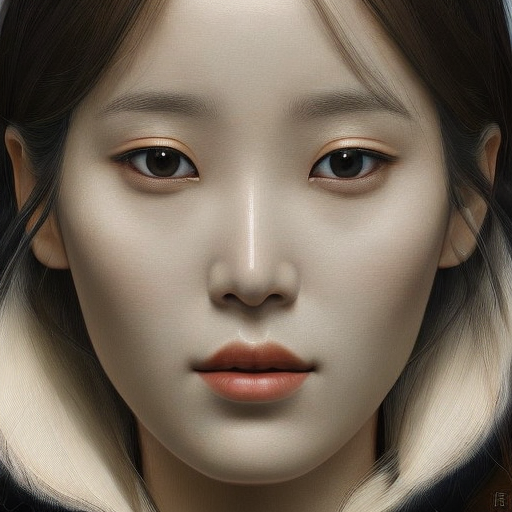

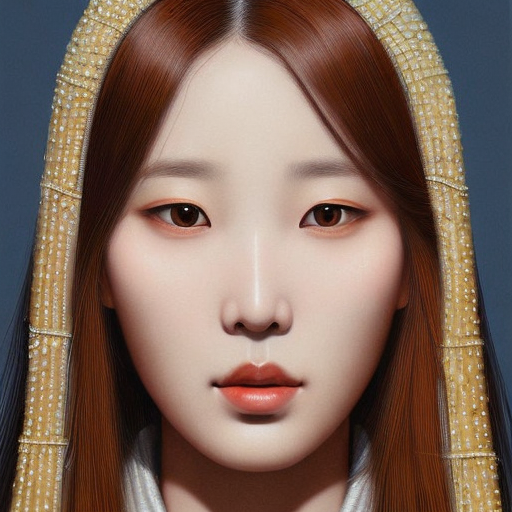

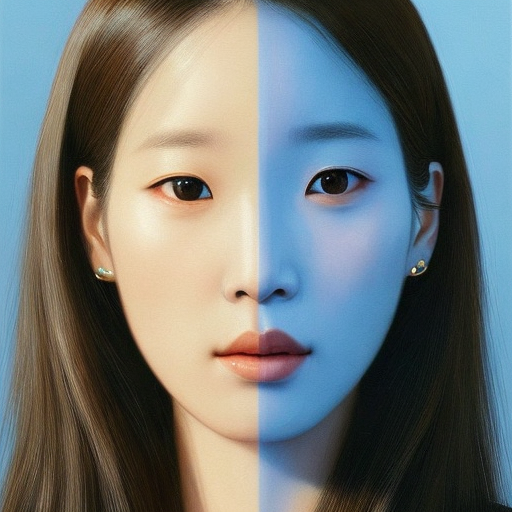

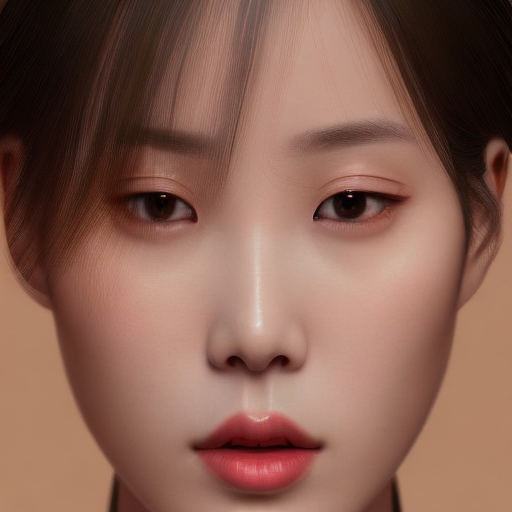

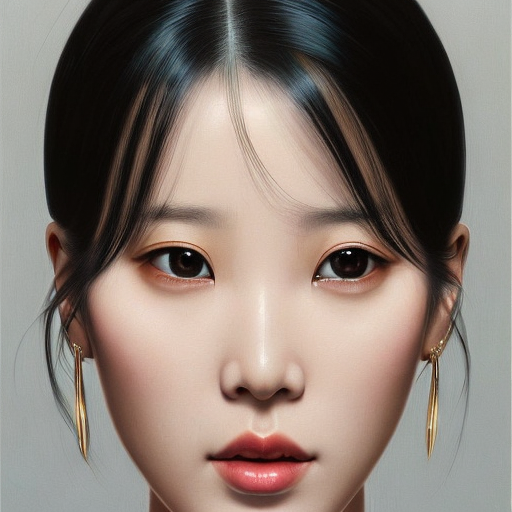

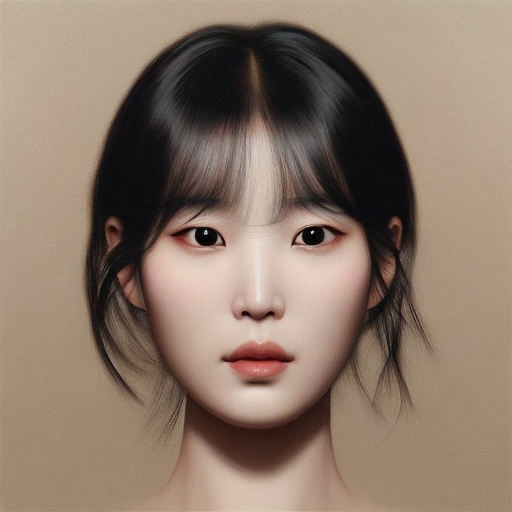

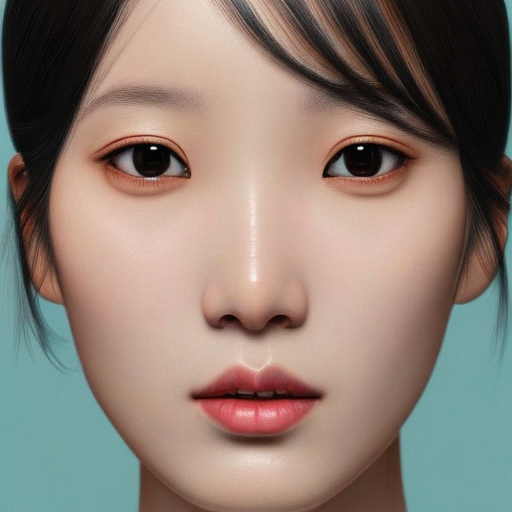

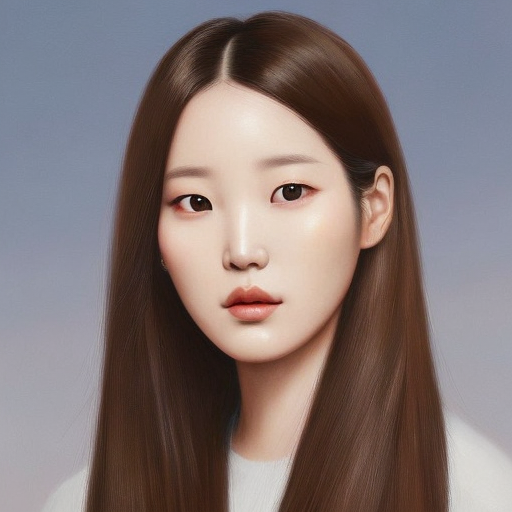

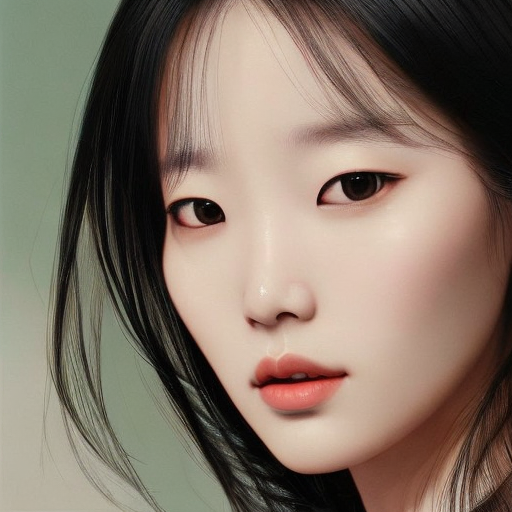

In [7]:
#@title Run for generating images.

prompt = "face portrait of secourses, symmetrical, detailed face, insanely detailed, concept art, trending on artstation, daily deviations Highly Realistic sharp, elegant. by Rockstar Games, digital painting, looking into the camera" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 80 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for index,img in enumerate(images):
    img.save(os.path.join("/content/output",str(index)+".jpg"))
    display(img)

  0%|          | 0/50 [00:00<?, ?it/s]

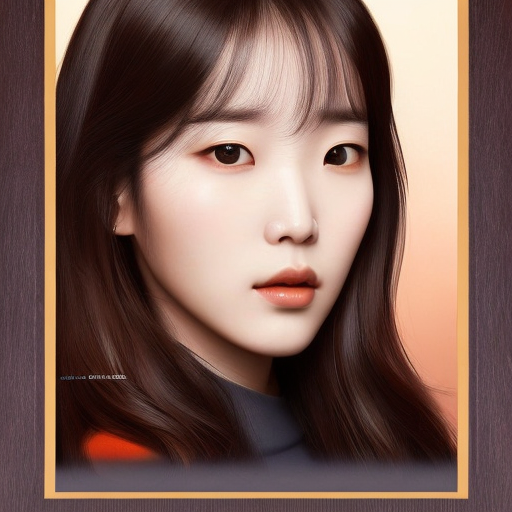

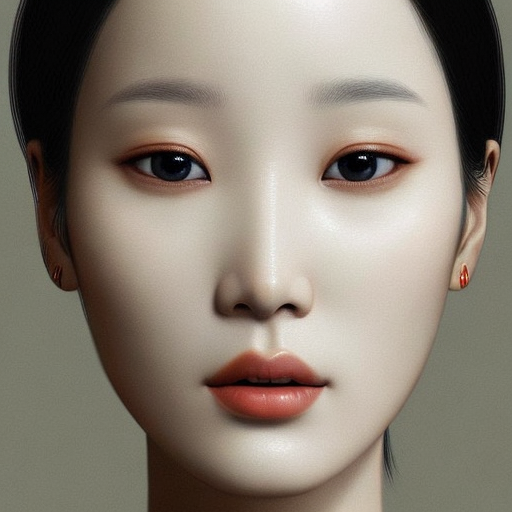

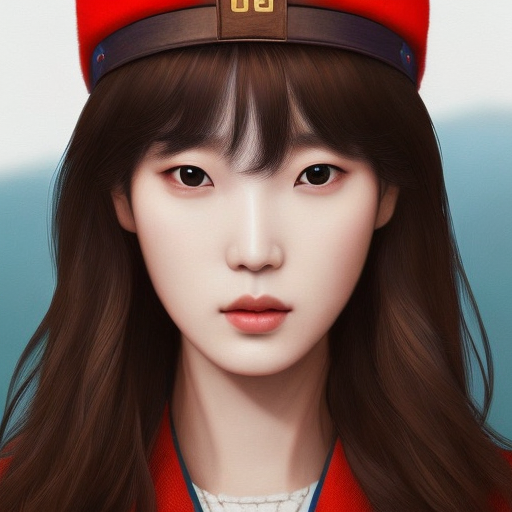

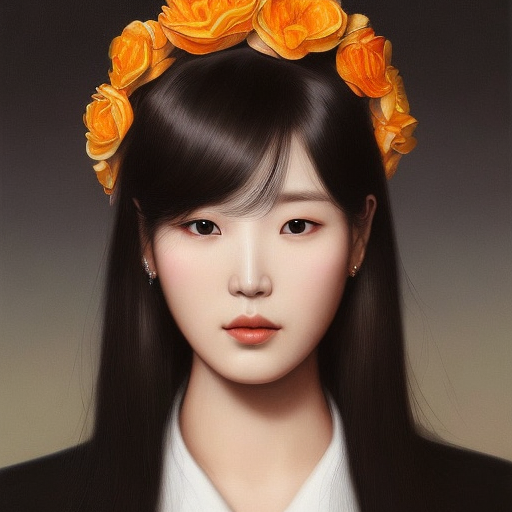

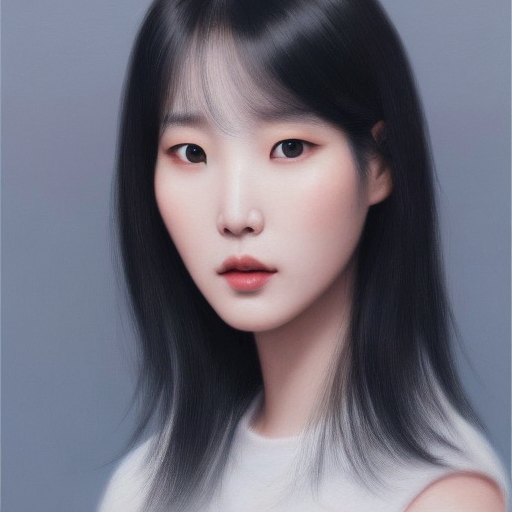

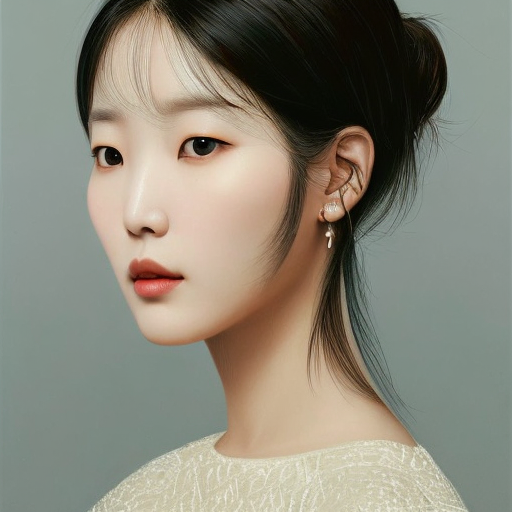

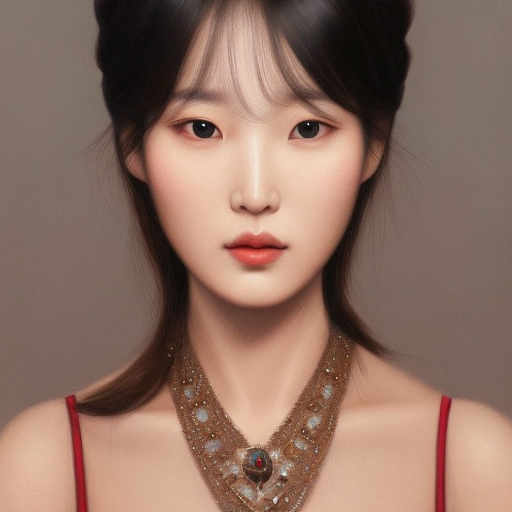

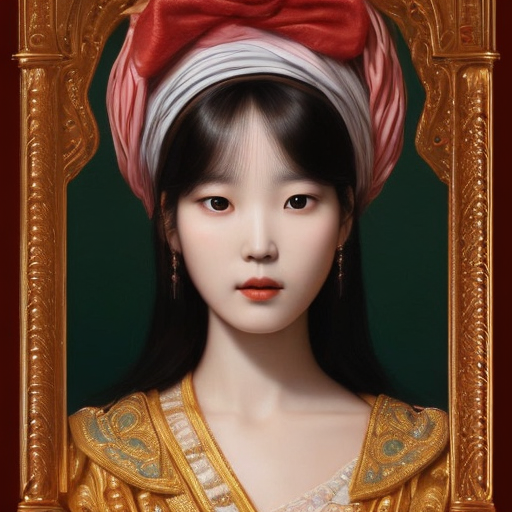

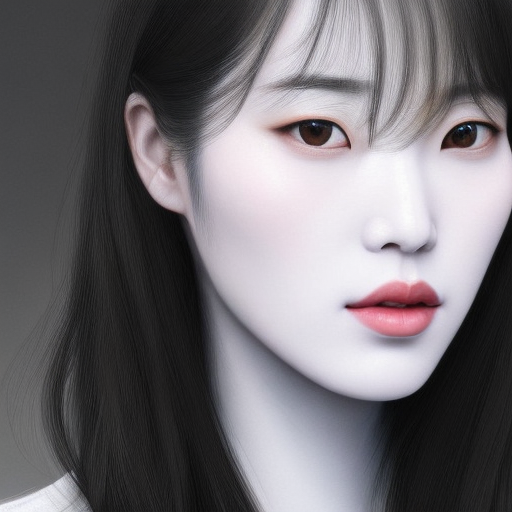

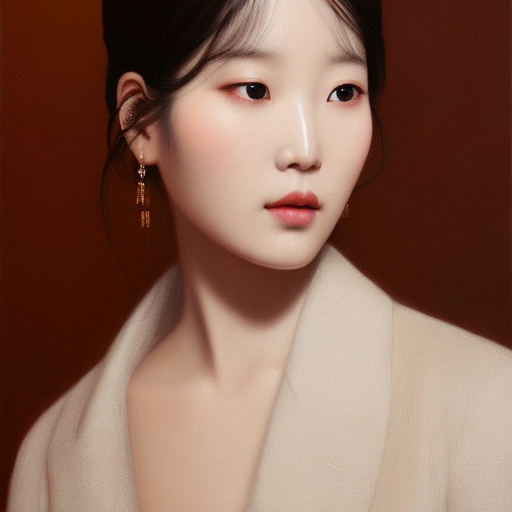

In [8]:
#@title Run for generating images.

prompt = "face portrait of secourses, symmetrical, detailed face, insanely detailed, concept art, trending on artstation, daily deviations Highly Realistic sharp, elegant. by Rockstar Games, digital painting, looking into the camera" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/50 [00:00<?, ?it/s]

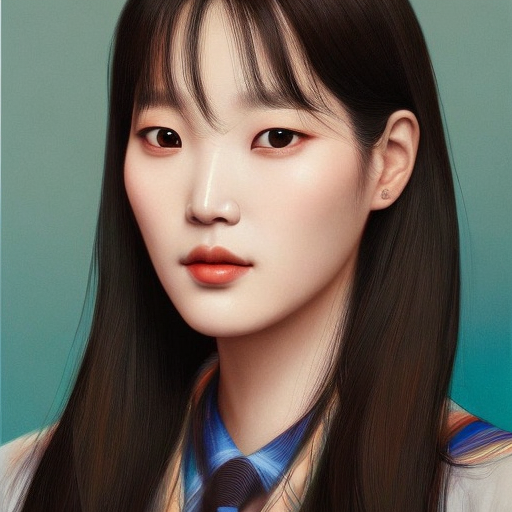

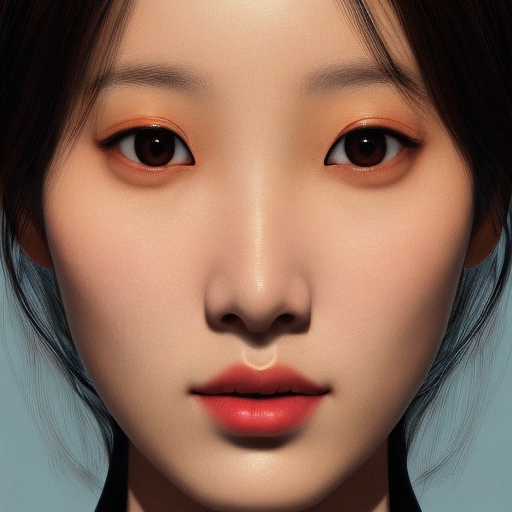

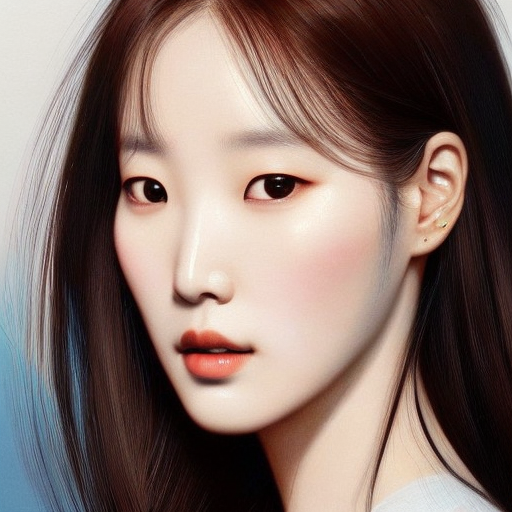

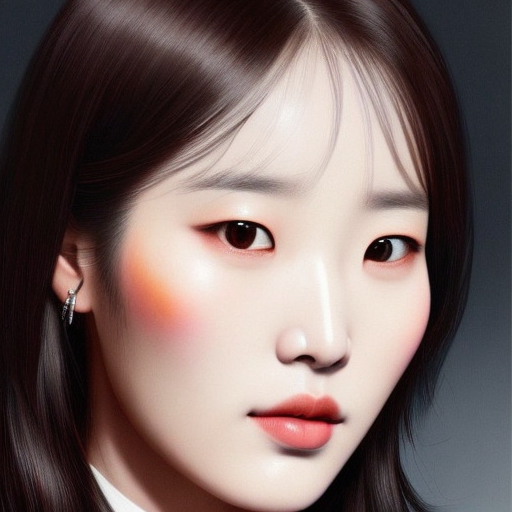

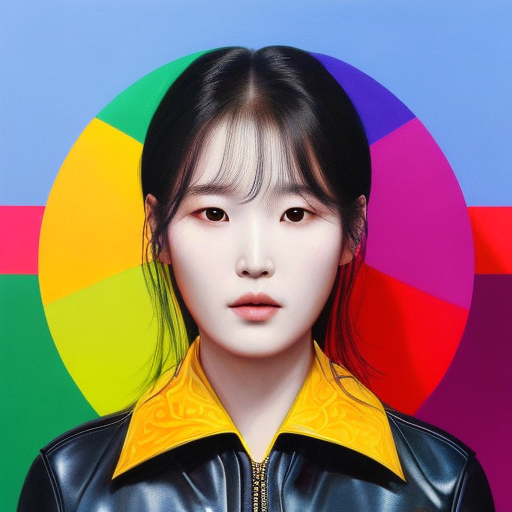

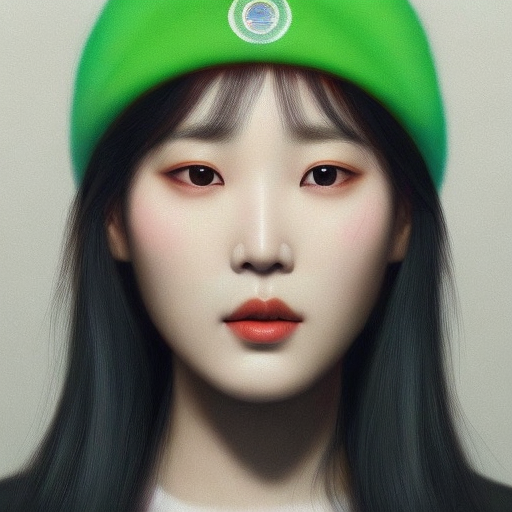

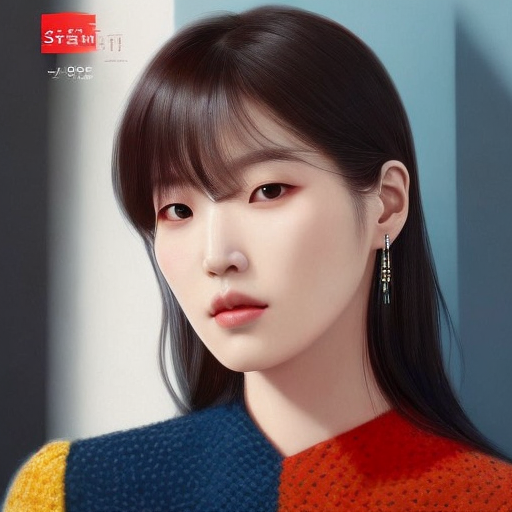

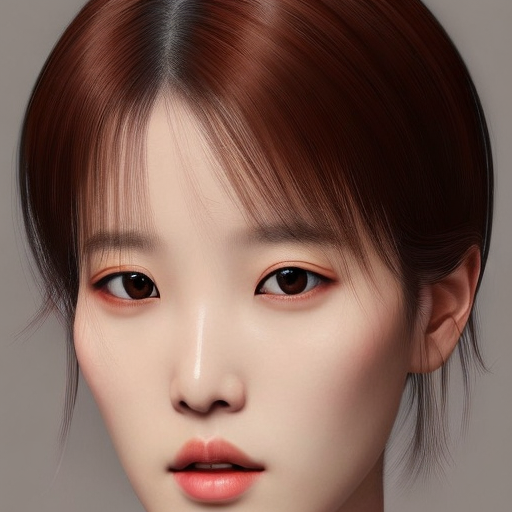

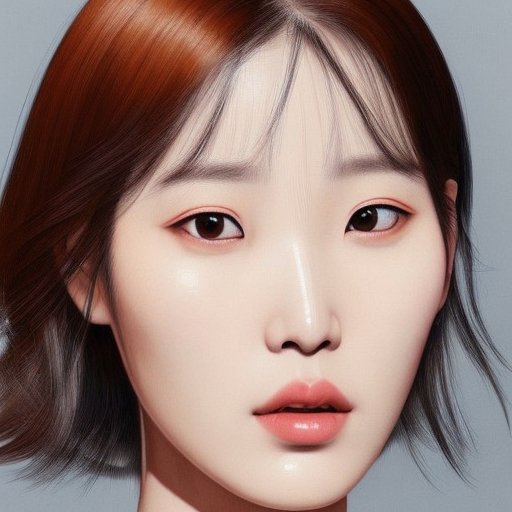

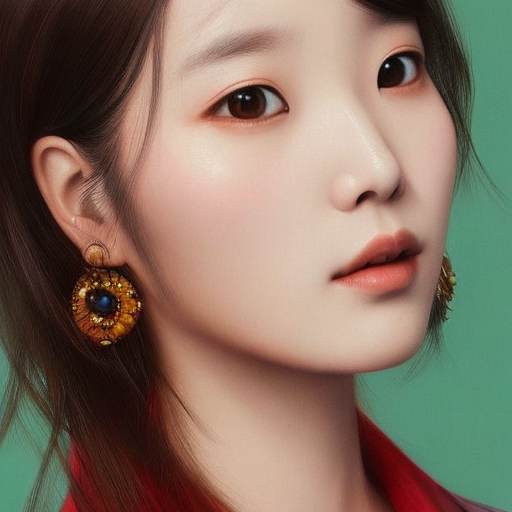

In [9]:
#@title Run for generating images.

prompt = "face portrait of secourses, colored,symmetrical, detailed face, ultra realistic by Quantic Dream, concept art, trending on artstation, daily deviations Highly Realistic sharp" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/50 [00:00<?, ?it/s]

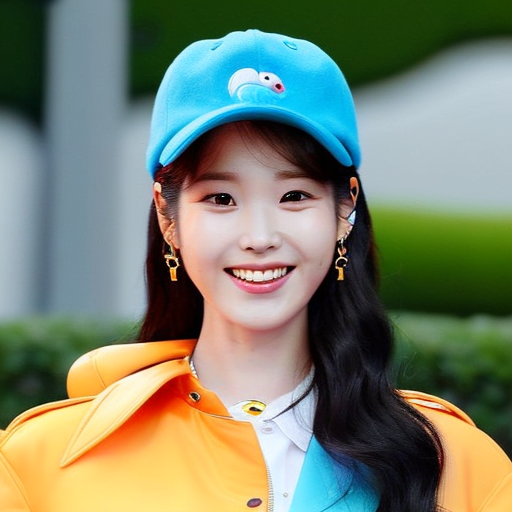

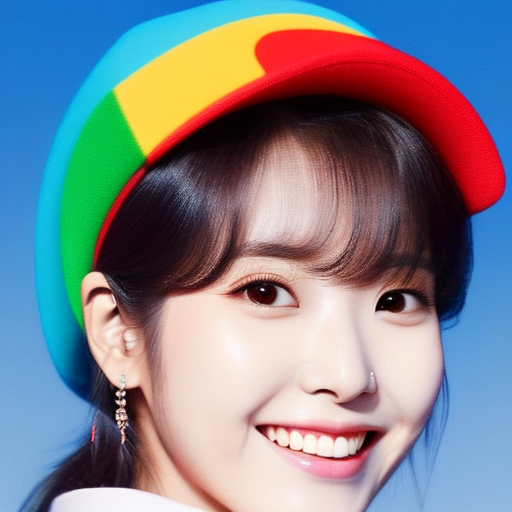

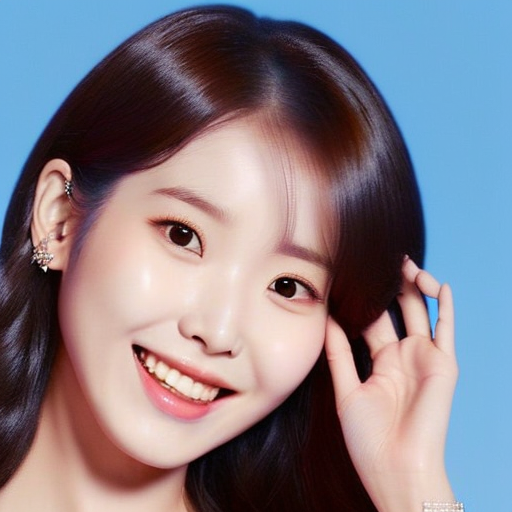

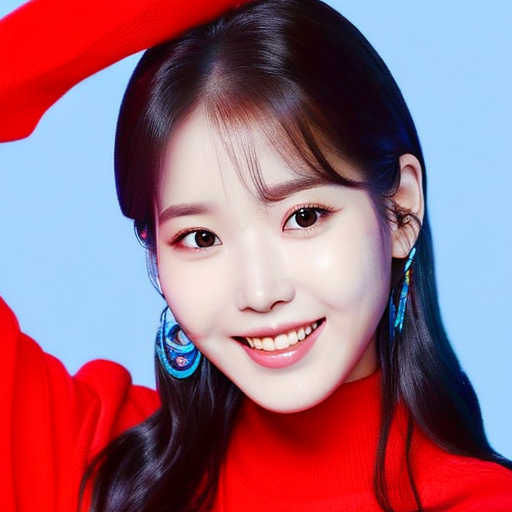

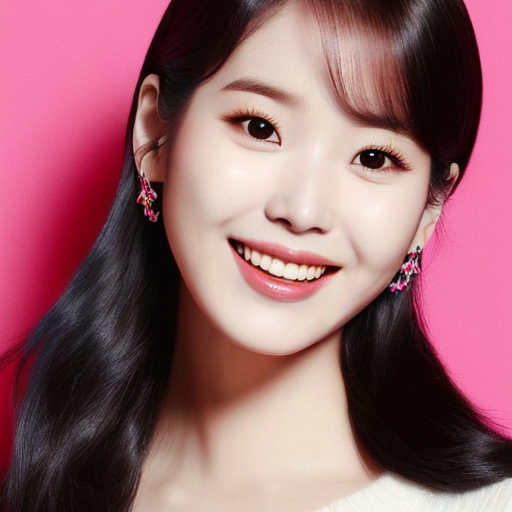

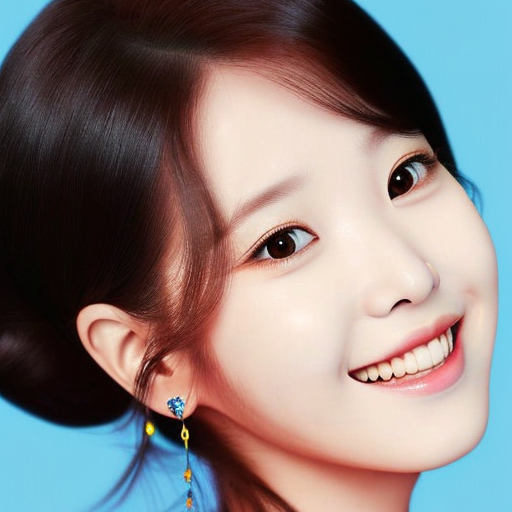

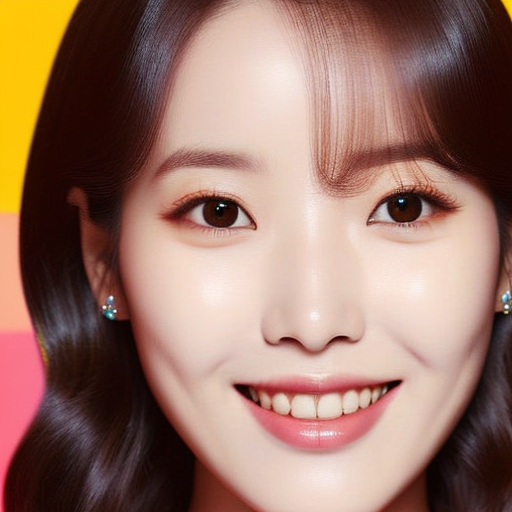

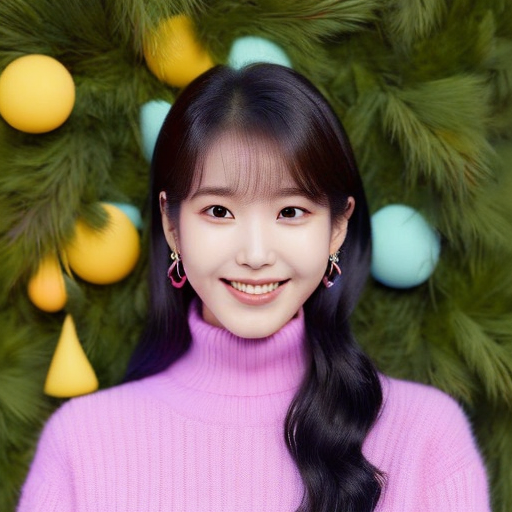

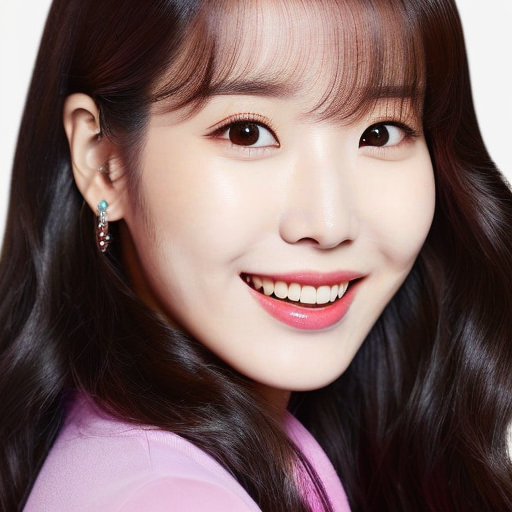

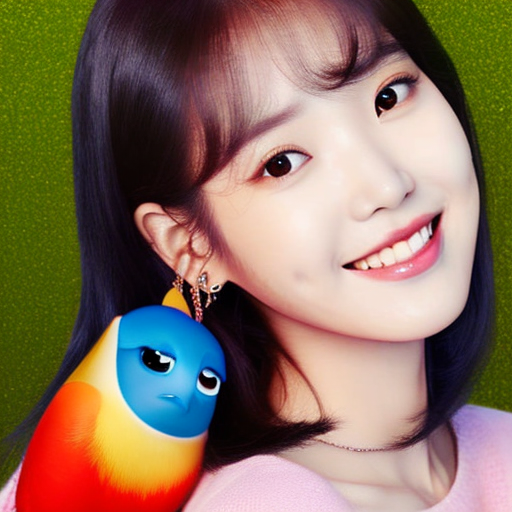

In [20]:
#@title Run for generating images.

prompt = "face portrait of secourses, colored,Pixar, Disney character, 3D render, high quality, smooth render, cute smile" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 11 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/50 [00:00<?, ?it/s]

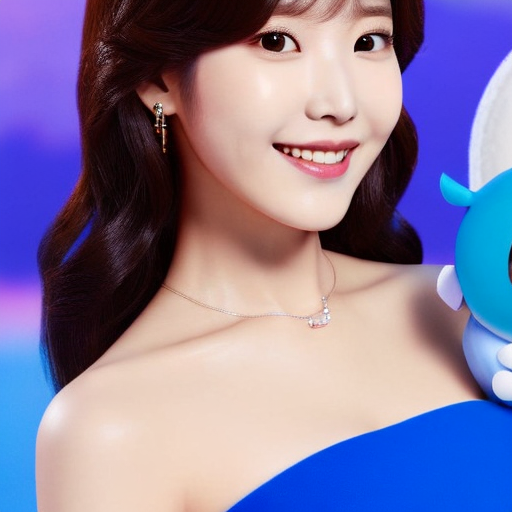

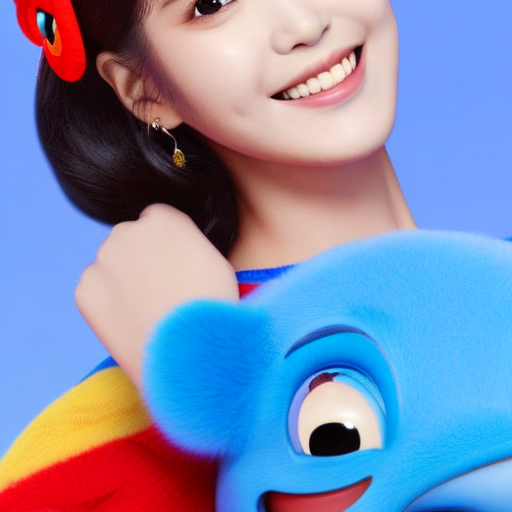

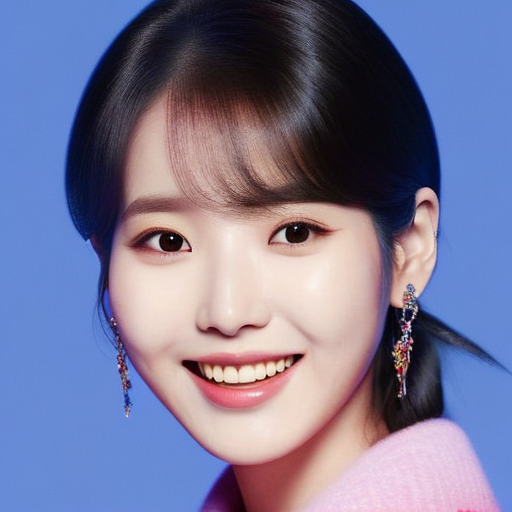

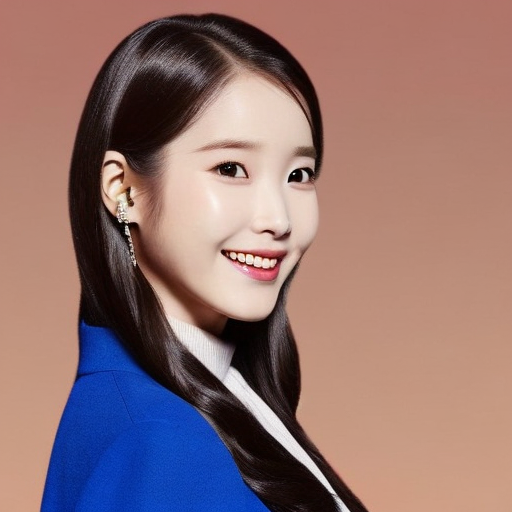

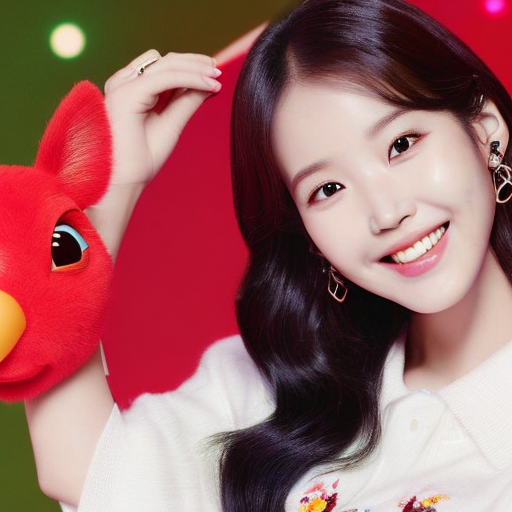

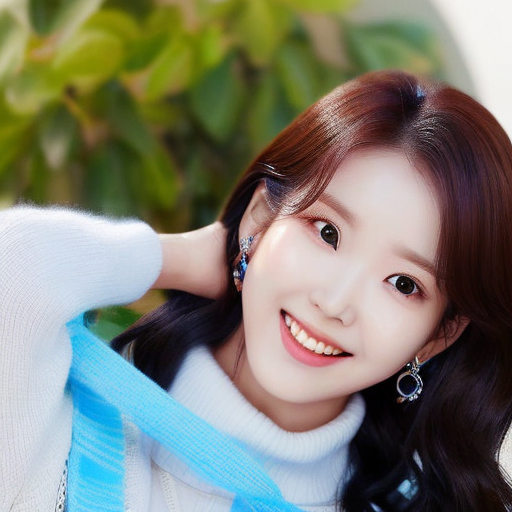

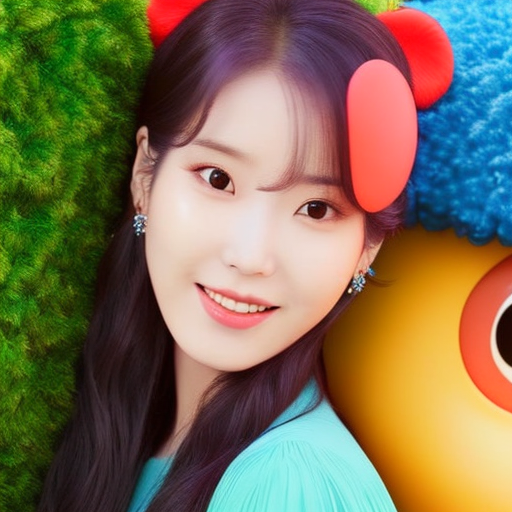

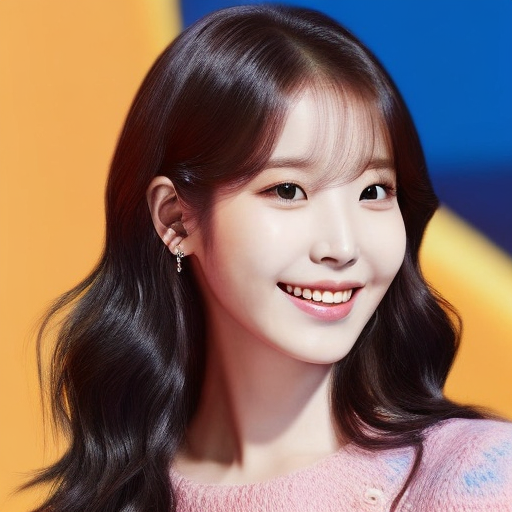

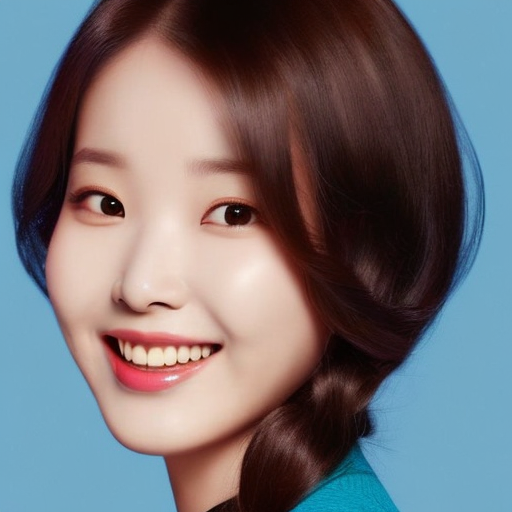

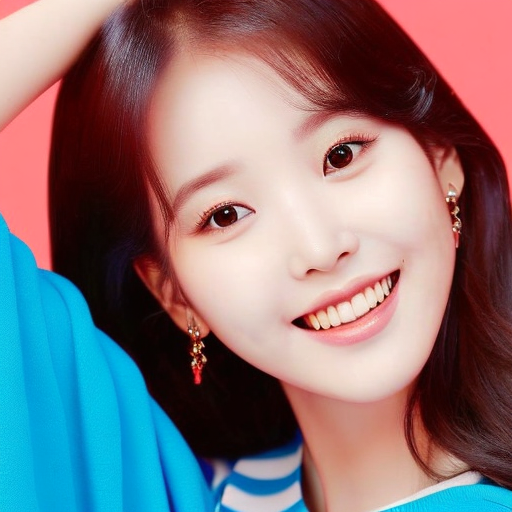

In [19]:
#@title Run for generating images.

prompt = "face portrait of secourses, colored,Pixar, Disney character, 3D render, high quality, smooth render, cute smile" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 9 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/50 [00:00<?, ?it/s]

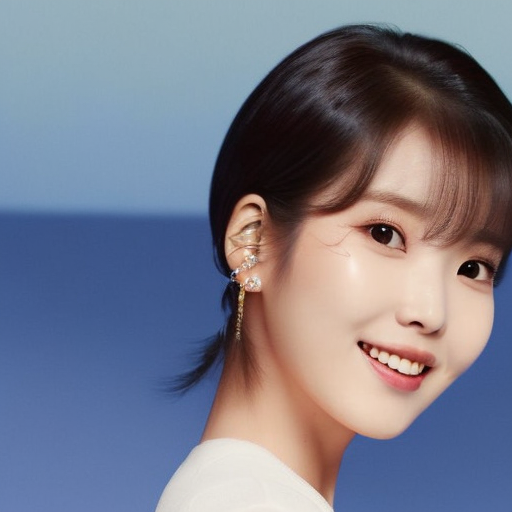

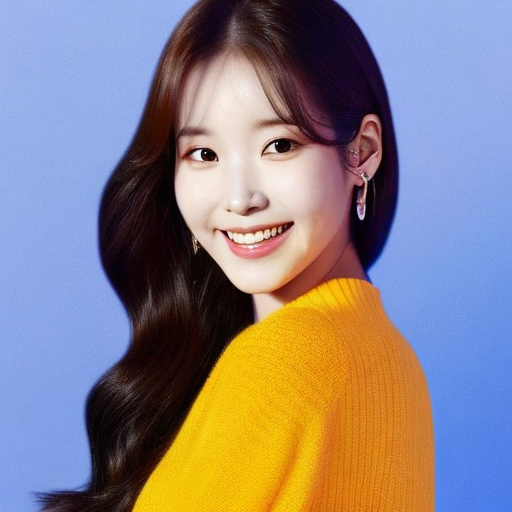

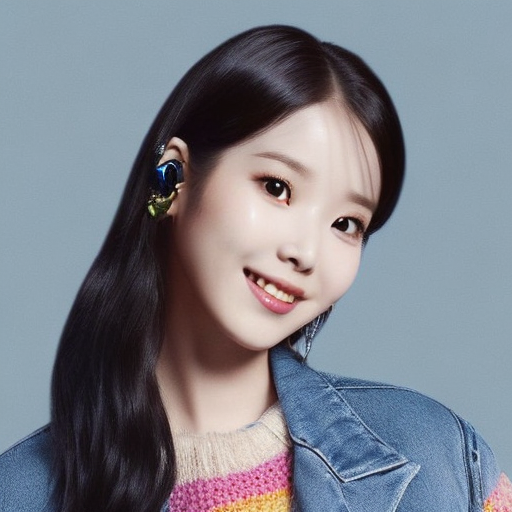

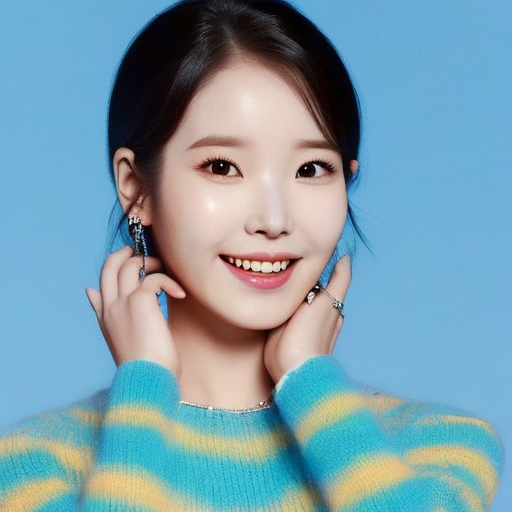

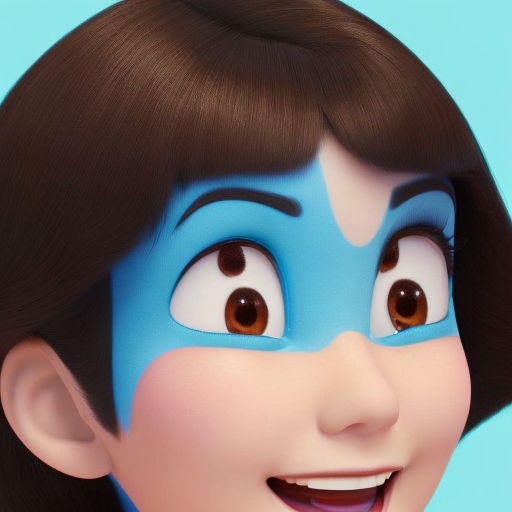

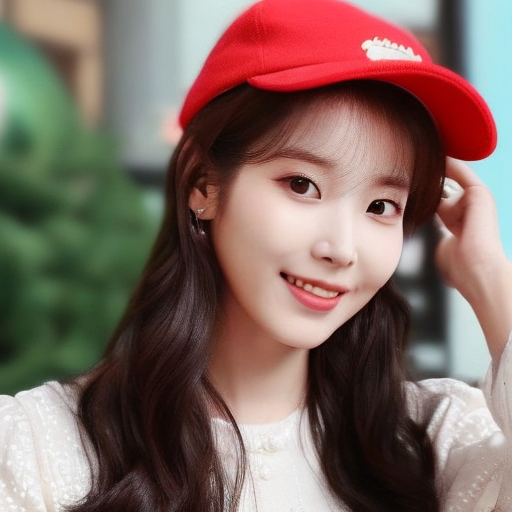

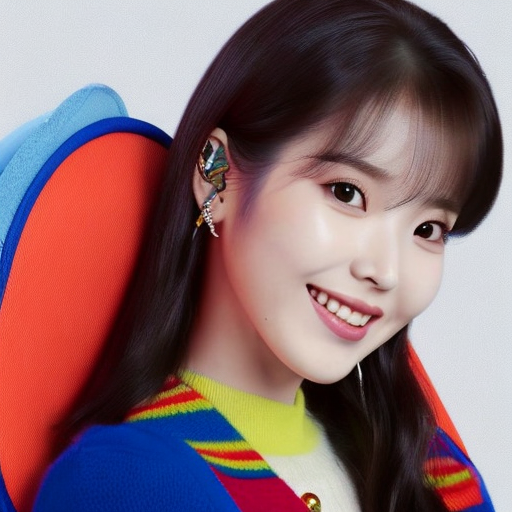

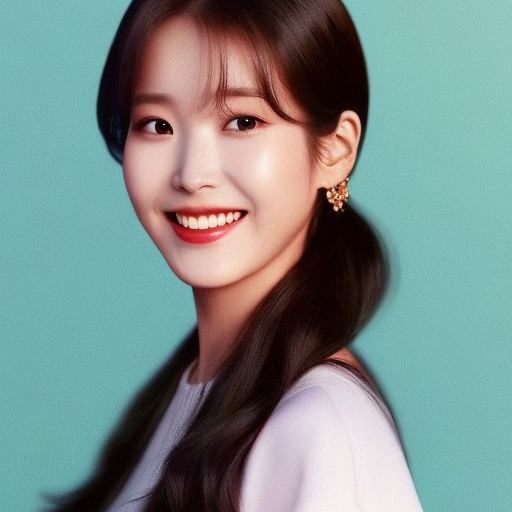

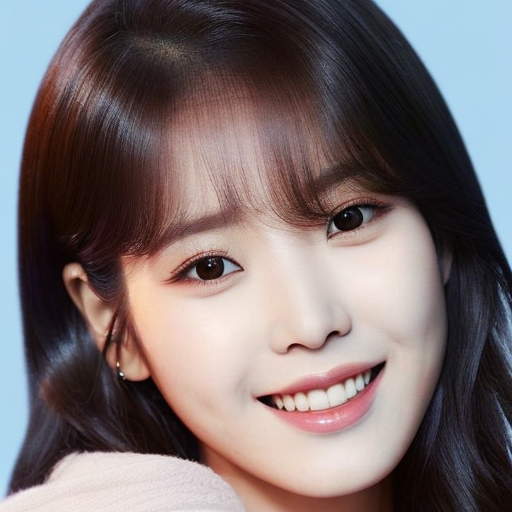

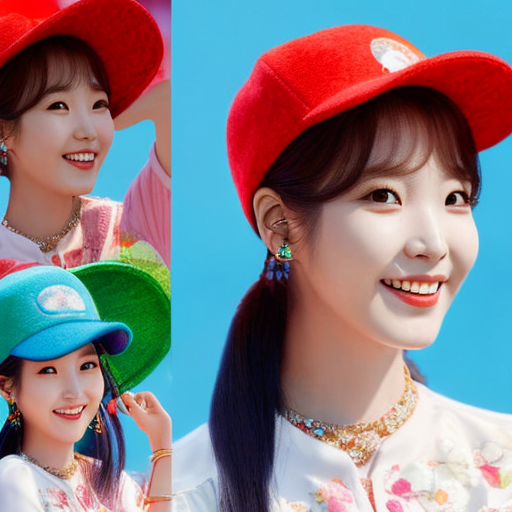

In [18]:
#@title Run for generating images.

prompt = "face portrait of secourses, colored,Pixar, Disney character, 3D render, high quality, smooth render, cute smile" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/50 [00:00<?, ?it/s]

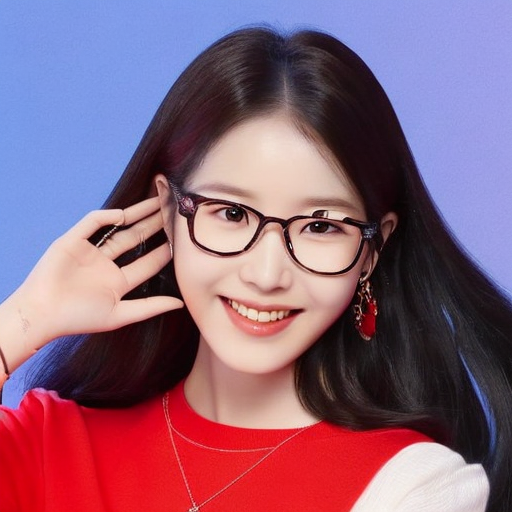

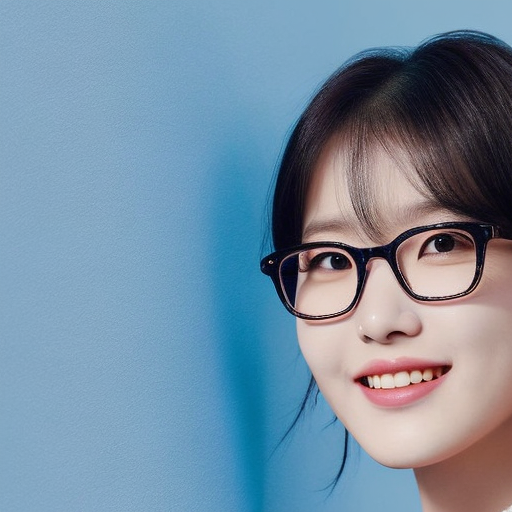

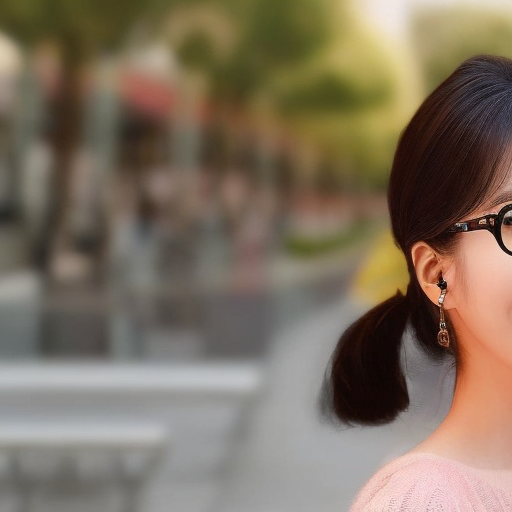

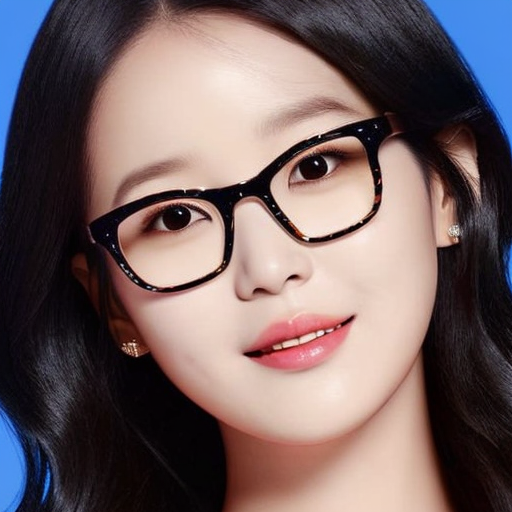

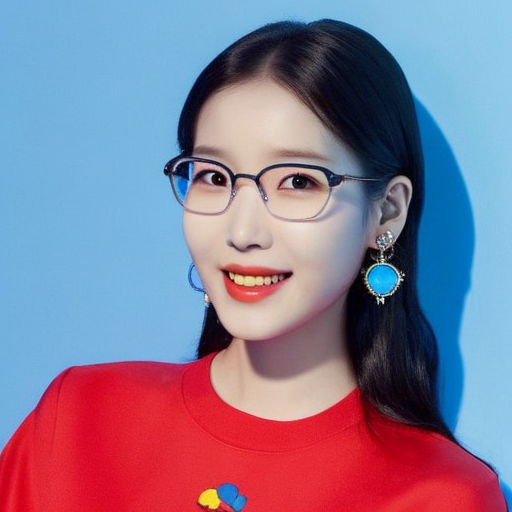

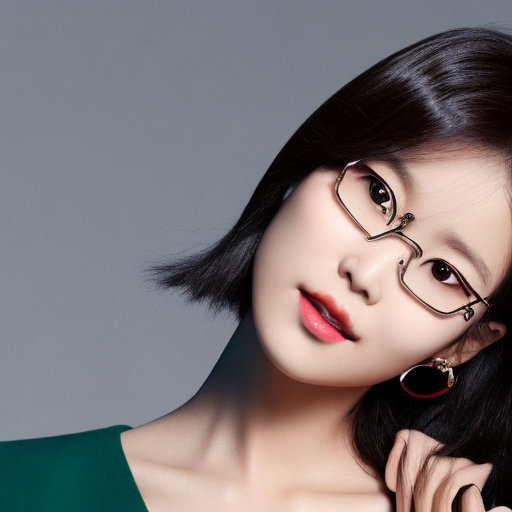

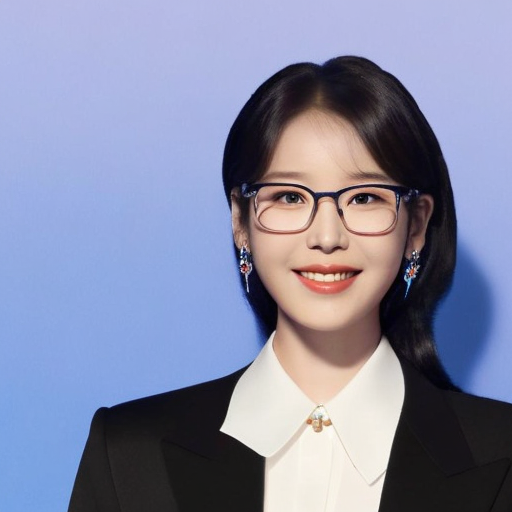

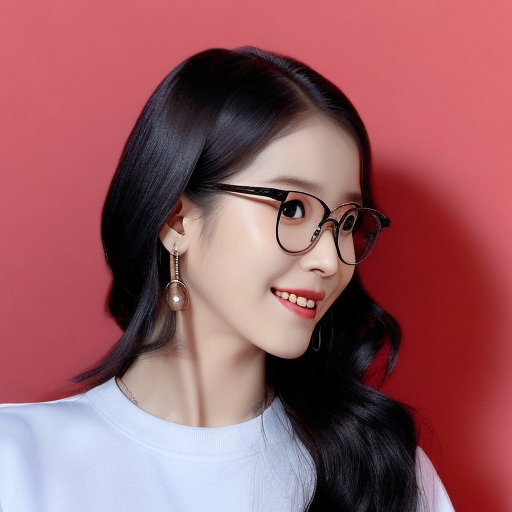

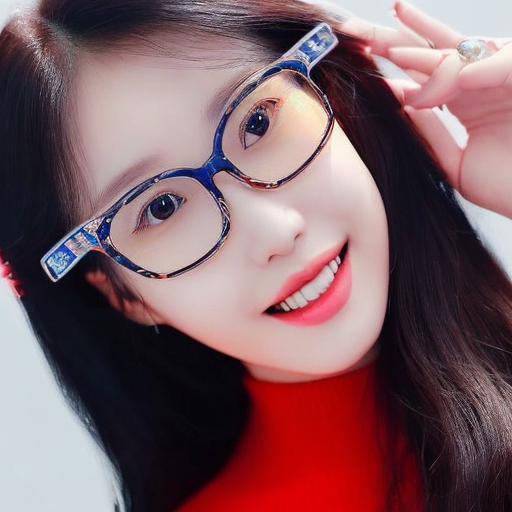

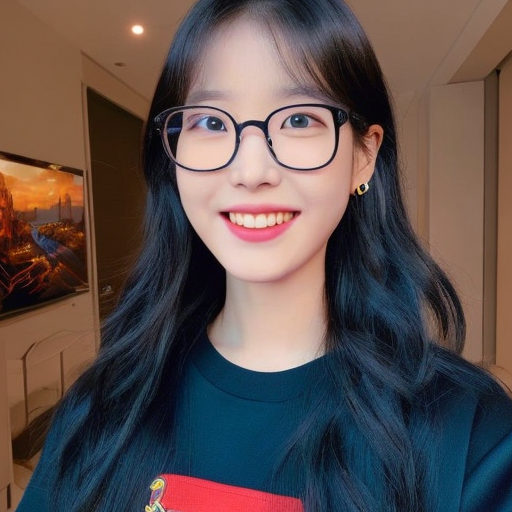

In [17]:
#@title Run for generating images.

prompt = "face portrait of secourses, colored,Pixar, Disney character, 3D render, high quality, smooth render, cute smile" #@param {type:"string"}
negative_prompt = "bad anatomy, bw, black and white, ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, blurry bad anatomy, blurred" #@param {type:"string"}
num_samples = 10 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)